### Importing Libraries

In [1]:
import numpy as np
import pandas as pd
from os import listdir
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
from keras.preprocessing import image
from keras.layers import *
from keras.models import Sequential
from keras.utils import to_categorical

Using TensorFlow backend.


In [72]:
#setting path to shapes dataset
FILEPATH = "dataset/output"

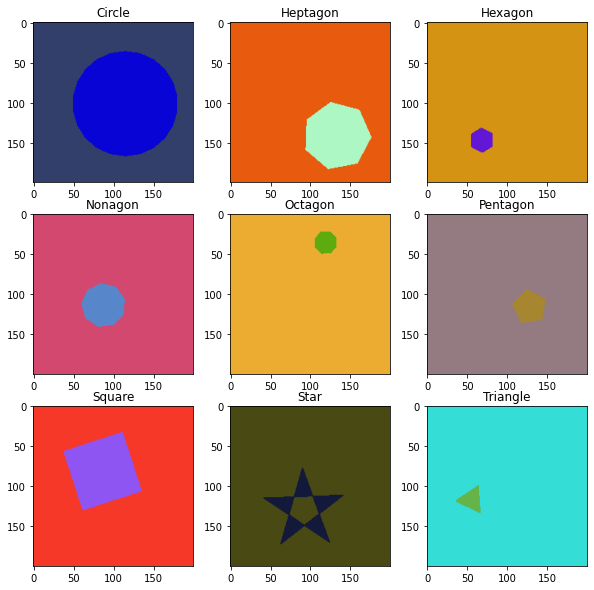

In [77]:
#creating main plot
plt.figure(figsize=(10, 10))

#plotting one of each shape
for i in range(9):
    
    #obtaining images for each shape
    shape_list = listdir(FILEPATH)[10000*i:10000*(i+1)]
    #sampling random image for that shape
    random_shape = np.random.choice(shape_list)
    #extracting name of shape from path
    shape_name = random_shape.split('_')[0].strip()
    #loading the image
    img = image.load_img(FILEPATH + '/' + random_shape)
    #plotting the image
    sub_fig = plt.subplot(3, 3, i+1)
    sub_fig.set_title(shape_name)
    plt.imshow(img)

In [20]:
def create_dataset(filepath, fraction, size):
    
    """
    Function to create dataset from file directory of shapes images. It includes loading each
    image, downsampling and scaling of the image, and assigning the appropriate shape label
    to the image.
    
    Parameters
    ----------
    filepath: str
        The filepath were the shapes dataset is located.
    fraction: float
        The fraction of the dataset to sample. Used to avoid memory problems.
    size: tuple (int, int)
        The target size of the loaded images. Used to achieve uniform size between all images
        and to manage the memory to store each image.
        
    Returns
    -------
    images: numpy array
        Array of shape (fraction*90000, size[0], size[1], 1) containing scaled images in array format
    labels: numpy array
        Array of strings corresponding to the shape labels of each image
    """
    #defining lists to store each image and label
    images = []
    labels = []
    
    #looping over every image in filepath
    for filename in listdir(filepath):
        
        #sampling fraction of images randomly
        if np.random.rand() >= (1.0-fraction):
            
            #extracting the shape name from the image file name
            shape_name = filename.split('_')[0].strip()
            #loading the image in grayscale with the specified size and highest quality interpolation
            shape_img = image.load_img(path=filepath + '/' + filename, 
                                       color_mode='grayscale', 
                                       target_size = size,
                                       interpolation='box')
            #converting image to array
            shape_img_arr = image.img_to_array(shape_img)
            #converting values to float
            shape_img_arr = shape_img_arr.astype('float32')
            #scaling images down via dividing by max intensity value
            shape_img_arr /= 255.0

            #appending images and labels to their respective lists
            images.append(shape_img_arr)
            labels.append(shape_name)
            
            #printing progress every 100 images
            if len(labels) % 100 == 0:
                print(str(len(labels)) + " images loaded...")
        
        else:
            continue
    
    #converting image and labels lists to array
    images = np.array(images)
    labels = np.array(labels)
    
    return images, labels

In [21]:
# Using function to create dataset of 64x64 images from entire directory
X, y = create_dataset('dataset/output', 1.0, (64, 64))

100 images loaded...
200 images loaded...
300 images loaded...
400 images loaded...
500 images loaded...
600 images loaded...
700 images loaded...
800 images loaded...
900 images loaded...
1000 images loaded...
1100 images loaded...
1200 images loaded...
1300 images loaded...
1400 images loaded...
1500 images loaded...
1600 images loaded...
1700 images loaded...
1800 images loaded...
1900 images loaded...
2000 images loaded...
2100 images loaded...
2200 images loaded...
2300 images loaded...
2400 images loaded...
2500 images loaded...
2600 images loaded...
2700 images loaded...
2800 images loaded...
2900 images loaded...
3000 images loaded...
3100 images loaded...
3200 images loaded...
3300 images loaded...
3400 images loaded...
3500 images loaded...
3600 images loaded...
3700 images loaded...
3800 images loaded...
3900 images loaded...
4000 images loaded...
4100 images loaded...
4200 images loaded...
4300 images loaded...
4400 images loaded...
4500 images loaded...
4600 images loaded.

36200 images loaded...
36300 images loaded...
36400 images loaded...
36500 images loaded...
36600 images loaded...
36700 images loaded...
36800 images loaded...
36900 images loaded...
37000 images loaded...
37100 images loaded...
37200 images loaded...
37300 images loaded...
37400 images loaded...
37500 images loaded...
37600 images loaded...
37700 images loaded...
37800 images loaded...
37900 images loaded...
38000 images loaded...
38100 images loaded...
38200 images loaded...
38300 images loaded...
38400 images loaded...
38500 images loaded...
38600 images loaded...
38700 images loaded...
38800 images loaded...
38900 images loaded...
39000 images loaded...
39100 images loaded...
39200 images loaded...
39300 images loaded...
39400 images loaded...
39500 images loaded...
39600 images loaded...
39700 images loaded...
39800 images loaded...
39900 images loaded...
40000 images loaded...
40100 images loaded...
40200 images loaded...
40300 images loaded...
40400 images loaded...
40500 image

72000 images loaded...
72100 images loaded...
72200 images loaded...
72300 images loaded...
72400 images loaded...
72500 images loaded...
72600 images loaded...
72700 images loaded...
72800 images loaded...
72900 images loaded...
73000 images loaded...
73100 images loaded...
73200 images loaded...
73300 images loaded...
73400 images loaded...
73500 images loaded...
73600 images loaded...
73700 images loaded...
73800 images loaded...
73900 images loaded...
74000 images loaded...
74100 images loaded...
74200 images loaded...
74300 images loaded...
74400 images loaded...
74500 images loaded...
74600 images loaded...
74700 images loaded...
74800 images loaded...
74900 images loaded...
75000 images loaded...
75100 images loaded...
75200 images loaded...
75300 images loaded...
75400 images loaded...
75500 images loaded...
75600 images loaded...
75700 images loaded...
75800 images loaded...
75900 images loaded...
76000 images loaded...
76100 images loaded...
76200 images loaded...
76300 image

In [23]:
#encoding string image labels to numeric
y_enc = LabelEncoder().fit_transform(y)

In [25]:
#splitting data into training (80%) and testing (20%) sets
X_train, X_test, y_train, y_test = train_test_split(X, y_enc, test_size=0.2, stratify=y_enc, shuffle=True, random_state=42)

In [26]:
#checking shape of X_train
X_train.shape

(72000, 64, 64, 1)

In [27]:
def create_model()

    model = Sequential()

    model.add(Conv2D(64, (3, 3), activation='relu', input_shape=X[0].shape))
    model.add(MaxPooling2D((2, 2)))

    model.add(Conv2D(32, (3, 3), padding='same', activation='relu'))
    model.add(MaxPooling2D((2, 2)))

    model.add(Conv2D(16, (3, 3), padding='same', activation='relu'))
    model.add(MaxPooling2D((2, 2)))

    model.add(Flatten())

    model.add(Dense(128, activation='relu'))
    model.add(Dense(9, activation='softmax'))
    
    model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

    return model

In [ ]:
model = create_model()

In [28]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 62, 62, 64)        640       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 31, 31, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 31, 31, 32)        18464     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 15, 15, 32)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 15, 15, 16)        4624      
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 7, 7, 16)          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 784)              

In [31]:
#one hot encoding y_train and y_test
y_train_enc = to_categorical(y_train)
y_test_enc = to_categorical(y_test)

In [32]:
#fitting the model to the training data and monitoring testing data
model.fit(X_train, y_train_enc, epochs=25, batch_size=32, validation_data=(X_test, y_test_enc), use_multiprocessing=True, shuffle=True)

Train on 72000 samples, validate on 18000 samples
Epoch 1/25
72000/72000 [==============================] - 260s 4ms/step - loss: 1.5715 - accuracy: 0.3939 - val_loss: 1.0578 - val_accuracy: 0.6056
Epoch 2/25
72000/72000 [==============================] - 258s 4ms/step - loss: 0.8841 - accuracy: 0.6665 - val_loss: 0.8048 - val_accuracy: 0.6886
Epoch 3/25
72000/72000 [==============================] - 259s 4ms/step - loss: 0.6773 - accuracy: 0.7472 - val_loss: 0.6391 - val_accuracy: 0.7513
Epoch 4/25
72000/72000 [==============================] - 277s 4ms/step - loss: 0.5654 - accuracy: 0.7884 - val_loss: 0.5179 - val_accuracy: 0.8148
Epoch 5/25
72000/72000 [==============================] - 292s 4ms/step - loss: 0.4880 - accuracy: 0.8167 - val_loss: 0.4770 - val_accuracy: 0.8268
Epoch 6/25
72000/72000 [==============================] - 291s 4ms/step - loss: 0.4406 - accuracy: 0.8360 - val_loss: 0.4349 - val_accuracy: 0.8407
Epoch 7/25
72000/72000 [==============================] - 292s

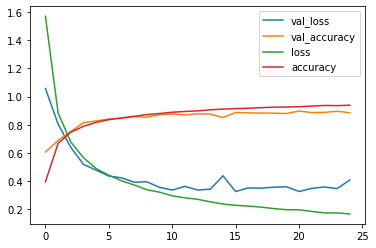

In [33]:
#visualizing loss and accuracy on training and validation/testing sets
pd.DataFrame(model.history.history).plot()

In [35]:
#obtaining model predictions on test set
y_pred = model.predict(X_test)

In [42]:
#obtaining dictionary of encodings in the form  {encoding: shape name}
labels = [(two, one) for one, two in zip(y, y_enc)]
labels = dict(set(labels))
labels

{8: 'Triangle',
 3: 'Nonagon',
 2: 'Hexagon',
 5: 'Pentagon',
 6: 'Square',
 0: 'Circle',
 1: 'Heptagon',
 7: 'Star',
 4: 'Octagon'}

In [43]:
labels_sorted = [labels[i] for i in range(len(labels))]

In [44]:
labels_sorted

['Circle',
 'Heptagon',
 'Hexagon',
 'Nonagon',
 'Octagon',
 'Pentagon',
 'Square',
 'Star',
 'Triangle']

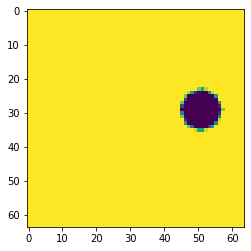

In [78]:
#displaying random image from test set
rand_num = np.random.randint(0, X_test.shape[0])
plt.imshow(X_test[rand_num].reshape(64, 64))

In [79]:
#Actual label for randomly sample image
labels_sorted[y_test[rand_num]]

'Octagon'

In [80]:
#Predicted label for randomly sampled image
labels_sorted[np.argmax(y_pred[rand_num])]

'Circle'

In [48]:
#undoing one hot encoding of y_pred for evaluation metrics compatibility
y_pred_single_column = [np.argmax(i) for i in y_pred]

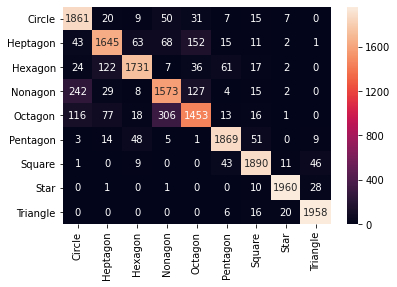

In [50]:
#plotting confusion matrix for the model
sns.heatmap(confusion_matrix(y_test, y_pred_single_column), annot=True, fmt='d', xticklabels=labels_sorted, yticklabels=labels_sorted)

In [416]:
#displaying classification report for each class in dataset
print(classification_report(y_test, y_pred_single_column, target_names=labels_sorted))

              precision    recall  f1-score   support

      Circle       0.78      0.76      0.77      2000
    Heptagon       0.84      0.76      0.80      2000
     Hexagon       0.80      0.88      0.84      2000
     Nonagon       0.69      0.69      0.69      2000
     Octagon       0.74      0.71      0.73      2000
    Pentagon       0.91      0.89      0.90      2000
      Square       0.92      0.94      0.93      2000
        Star       0.90      1.00      0.94      2000
    Triangle       0.98      0.94      0.96      2000

    accuracy                           0.84     18000
   macro avg       0.84      0.84      0.84     18000
weighted avg       0.84      0.84      0.84     18000



D:\Anaconda\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


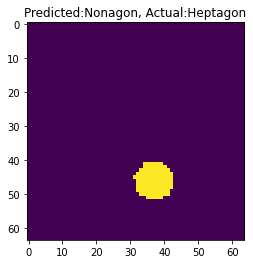

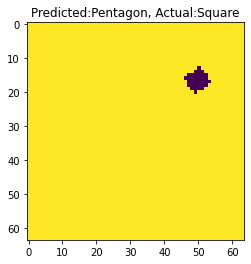

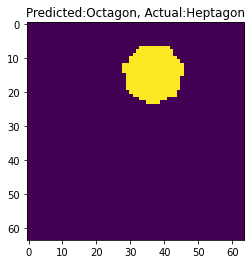

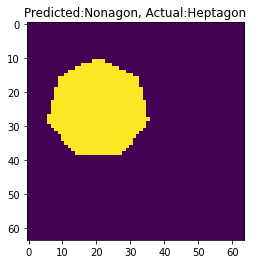

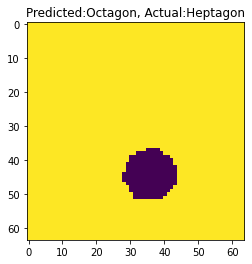

...

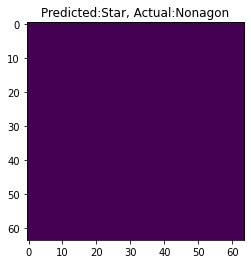

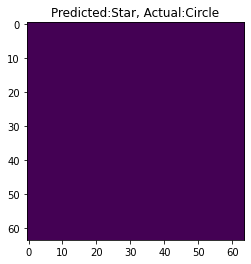

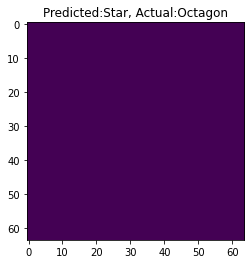

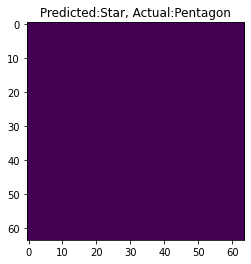

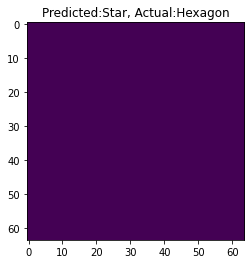

In [417]:
# displaying misclassified examples
for i in range(len(y_test)):
    if y_test[i]!=y_pred_single_column[i]:
        plt.figure()
        plt.imshow(X_test[i].reshape(64, 64))
        plt.title("Predicted:{}, Actual:{}".format(labels_sorted[y_pred_single_column[i]], labels_sorted[y_test[i]]))

In [58]:
#disabling training on all layers before saving
for layer in model.layers:
    layer.trainable=False

In [59]:
#saving model
model.save("shapes_classifier_nn")

In [138]:
plt.imshow(X_test[1235].reshape(64, 64))

In [81]:
outputs = [layer.output for layer in model.layers]

In [82]:
viz = keras.models.Model(inputs=model.input, outputs=outputs)

In [139]:
ex = X_test[1235]

In [140]:
feature_map = viz.predict(np.expand_dims(ex, axis=0))

In [141]:
layer_names = [layer.name for layer in model.layers]

In [142]:
for layer_name, feature_map in zip(layer_names, feature_map):
    if len(feature_map.shape)==4:
        print(feature_map.shape)
        print(layer_name)
        n_features = feature_map.shape[-1]
        dim = 4
        dim2 = n_features//dim
        ix = 1
        for _ in range(dim2):
            for _ in range(dim):
                ax = plt.subplot(dim, dim2, ix)
                ax.set_xticks([])
                ax.set_yticks([])
                plt.imshow(feature_map[0, :, :, ix-1], cmap='gray')
                ix += 1
        plt.show()

(1, 62, 62, 64)
conv2d_1


(1, 31, 31, 64)
max_pooling2d_1


(1, 31, 31, 32)
conv2d_2


(1, 15, 15, 32)
max_pooling2d_2


(1, 15, 15, 16)
conv2d_3


(1, 7, 7, 16)
max_pooling2d_3
